# マイクラの村人を検出する

顔検出は一般的には"人"に対して使われるイメージですが、人以外にも使えるのではないかと思い、今回は人気のゲームタイトルである「マインクラフト」に焦点をあてて、その中では一番"人"に近い村人を検出できるようにしてみました。

# No.1 今回検出に使用する画像

一枚目 村人の数は少なめで、遠くに居たりといったこともない
![alt text](img1.png)

二枚目 村人の数が多く、奥にも映っているほか、クリーパーのような村人とは関係ないMobまで映っている
![alt text](img2.png)

三枚目 目の前に大きく映っているもの以外はかなり小さく、さらに村人とは関係ないMobやオブジェクトがとても多い
![alt text](img3.png)

四枚目 ひとつ前の写真を別の角度から撮ったやつ
![alt text](img4.png)

五枚目 寝ているニートの村人一人だけ
![alt text](img5.png)

# No.2 顔検出コード

必要なライブラリを準備

In [1]:
!pip install ultralytics pillow pandas


   ---------------------------------------- 0.0/11.0 MB ? eta -:--:--
   -------------------------------------- - 10.5/11.0 MB 92.9 MB/s eta 0:00:01
   ---------------------------------------- 11.0/11.0 MB 29.8 MB/s eta 0:00:00



[notice] A new release of pip is available: 24.2 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


必要なライブラリの読み込み

In [2]:
from ultralytics import YOLO
from PIL import Image
from IPython.display import display
import glob
import pandas as pd
import os


モデルの読み込み

In [3]:
model_path = "C:/yolo/villager_project/runs/detect/train7/weights/best.pt"
model = YOLO(model_path)

print("モデル読み込み完了")


モデル読み込み完了


先ほどの5枚の画像から村人を検出して人数を表示


image 1/1 C:\yolo\villager_project\test_images\img1.png: 384x640 4 villagers, 14.3ms
Speed: 1.5ms preprocess, 14.3ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)
img1.png → 村人 4 人


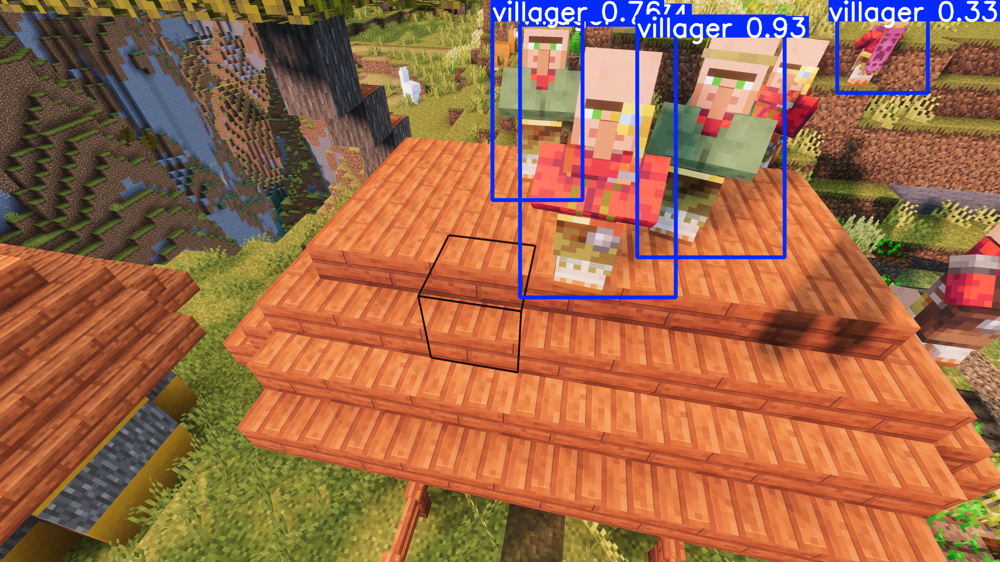


image 1/1 C:\yolo\villager_project\test_images\img2.png: 384x640 17 villagers, 15.9ms
Speed: 1.5ms preprocess, 15.9ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)
img2.png → 村人 17 人


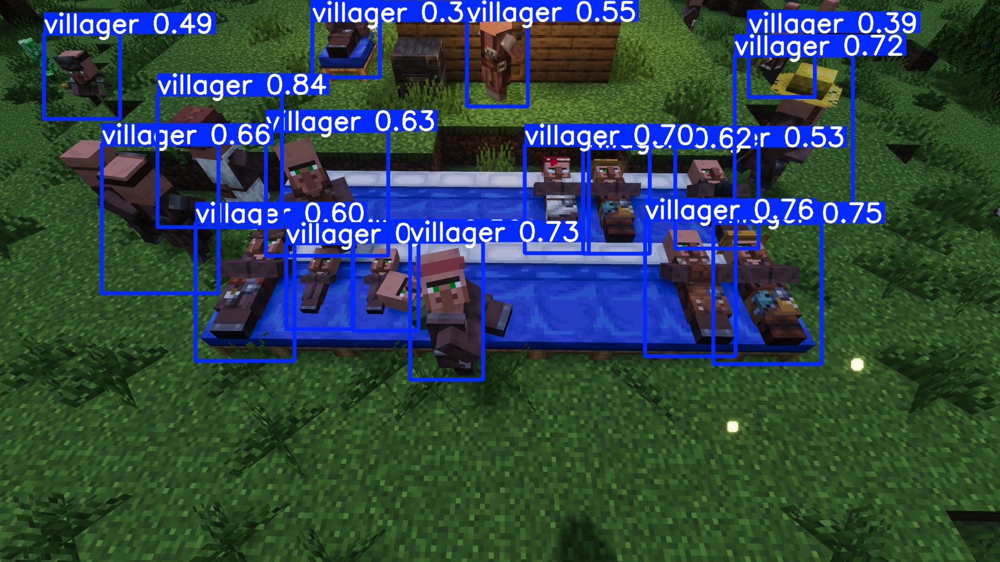


image 1/1 C:\yolo\villager_project\test_images\img3.png: 384x640 1 villager, 12.7ms
Speed: 0.9ms preprocess, 12.7ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)
img3.png → 村人 1 人


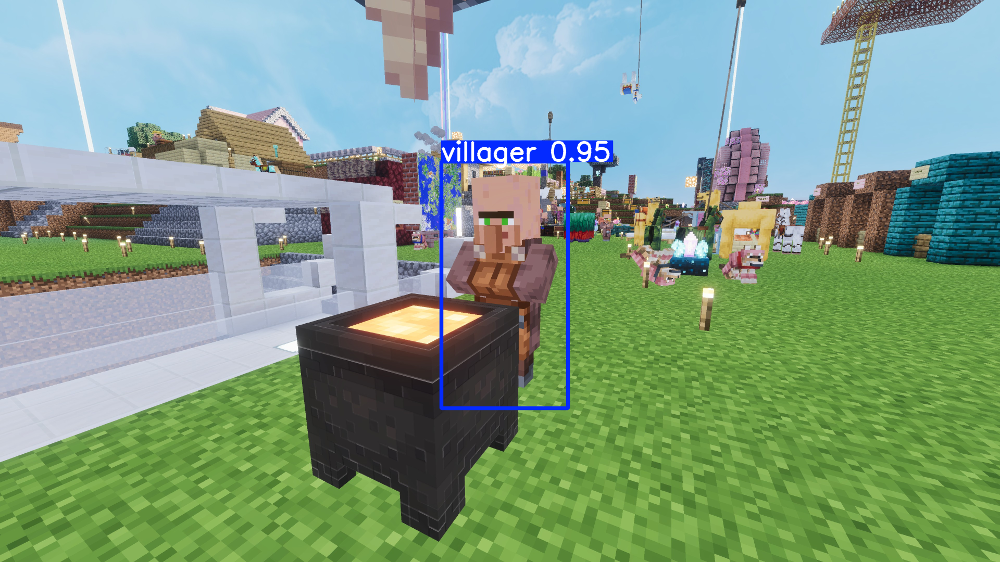


image 1/1 C:\yolo\villager_project\test_images\img4.png: 384x640 1 villager, 19.5ms
Speed: 1.8ms preprocess, 19.5ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)
img4.png → 村人 1 人


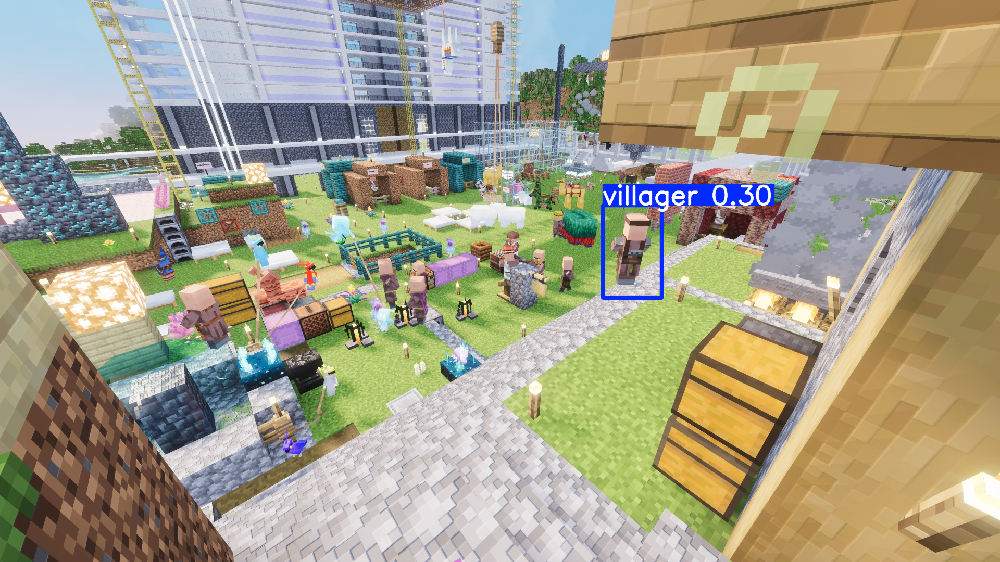


image 1/1 C:\yolo\villager_project\test_images\img5.png: 352x640 2 villagers, 18.6ms
Speed: 1.5ms preprocess, 18.6ms inference, 0.5ms postprocess per image at shape (1, 3, 352, 640)
img5.png → 村人 2 人


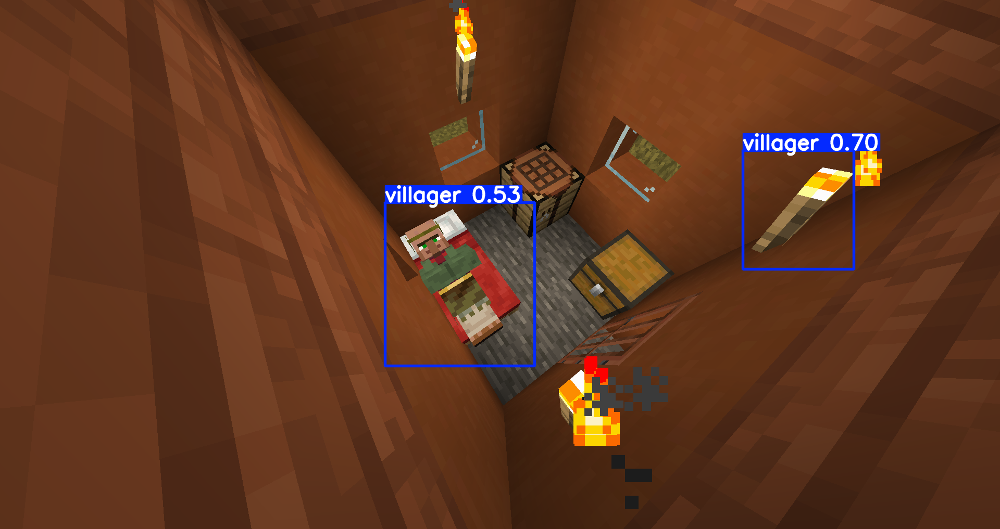

In [6]:
import cv2

image_folder = "C:/yolo/villager_project/test_images"
image_files = glob.glob(os.path.join(image_folder, "*.png"))

results_list = []

for img_path in image_files:
    results = model.predict(img_path, conf=0.25)
    villager_count = len(results[0].boxes)

    print(f"{os.path.basename(img_path)} → 村人 {villager_count} 人")

    result_img = results[0].plot()
    result_img = cv2.cvtColor(result_img, cv2.COLOR_BGR2RGB)
    display(Image.fromarray(result_img))

    results_list.append({
        "Image": os.path.basename(img_path),
        "Villager Count": villager_count
    })



検出結果を表形式で表示

In [5]:
df = pd.DataFrame(results_list)
df


,Image,Villager Count
0,img1.png,4
1,img2.png,17
2,img3.png,1
3,img4.png,1
4,img5.png,2


**おそらくgithub上では正常に動作しないので最後の方にNo.2のスクショを貼っておきます**

# No.3 検出結果の分析

村人のモデル学習に使用した画像が**54枚**しかなかったので、それ相応の出来といった具合であるように感じた。<br>
<br>
一枚目は別の村人に隠れているやつと右端で下半身しか映っていない村人が検出されなかったが、**ハッキリ見える4人の村人はしっかり検出されていた。**<br>
<br>
二枚目は子供含む大量の村人がいるにもかかわらず**ほとんど検出できていた**が、やはり奥に小さく映っている村人は検出されなかった。<font color="gray">クリーパーは検出されずに済んだようだ。</font><br>
<br>
三枚目は真ん中に大きく映っている村人は認識されたが奥の方にいる村人は残念ながら検出されなかった。当然ながら、スニッファーやラマ、馬やオオカミなどは一切検出されなかった。<br>
<br>
四枚目は三枚目よりも村人が見えやすい気がするが、こちらも丸石の階段の上にいる村人一人しか検出されなかった。<br>
<br>
最後五枚目はベッドで寝ている村人はしっかり検出されたものの、**なぜか壁に刺さっている松明が一本だけ村人として認識されてしまった**。~~そうはならんやろ~~


### ・全体の分析・特徴や気づいた点など

1.奥の方にいて小さくしか映っていない村人は検出されにくい<br>
<br>
2.村人が別の村人の後ろに隠れているなどによって重なってしまっている場合も検出されにくい<br>
<br>
3.五枚目の謎の松明を除けば村人以外のMobは検出されていなかったため、最低限の村人の特徴はしっかり学習できていると思われる<br>
<br>
<br>
上の結果や分析から、現状の学習データでは<font color="red">**近くにいて大きめに映っている村人であれば数が多めでも検出されやすい**</font>といえるだろう。

# No.4 所感

自分でテーマを設定していいとのことだったので、何かいままでにはないような顔検出システムを作りたいなと思って今回のテーマに決めました。提出課題としてOKなのかは分からないが、一から村人のデータを学習させ、実際に検出させることもできたので個人的には満足いく結果であると思う。<br>
正直、こういう場面では使えそうといった場面はなさそうだが、遊びとして使うにはありかもしれないと思う。

## 「No.2 顔検出コード」のスクショ

### <font color="red">画像サイズが約16MBと大きめなので少し重くなるかもしれないです。あと、縦にクソ長いです。</font><br>
###### あと、たまに少しおかしくなっているところがあります

<br><br><br><br><br><br><br><br><br><br><br><br><br><br><br><br><br><br><br><br><br><br><br><br><br>

![alt text](<2025-12-16 22 01 55.png>)